# Cápsula #3: Generative Adversarial Networks
#### EL7014 Teoría de la Información: Fundamentos y Aplicaciones <br> Information and Decision Systems Group

En la presente cápsula se presentan los fundamentos teóricos y ejemplos experimentales de los modelos [GAN](https://arxiv.org/pdf/1406.2661.pdf) (Goodfellow et al., 2014) e [InfoGAN](https://arxiv.org/pdf/1606.03657.pdf) (Chen et al., 2017).

In [0]:
import os
import time
import glob
import imageio
import torch
import torch.nn as nn
import torch.optim as optim
import torch.autograd as autograd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
from torch.utils.data import DataLoader
from torchvision.utils import save_image
from torchvision import datasets, transforms

In [0]:
# Datasets
MNIST_dataset = datasets.MNIST('.', transform=transforms.ToTensor(), download=True)
FashionMNIST_dataset = datasets.FashionMNIST('.', transform=transforms.ToTensor(), download=True)

0it [00:00, ?it/s]

9920512it [00:01, 8436819.55it/s]                            


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


  0%|          | 0/28881 [00:00<?, ?it/s]

32768it [00:00, 129856.13it/s]           
  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw


1654784it [00:00, 2354054.08it/s]                           
0it [00:00, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


8192it [00:00, 49081.62it/s]            
  0%|          | 16384/26421880 [00:00<02:49, 156213.65it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!


26427392it [00:00, 77788627.61it/s]                            


Extracting ./FashionMNIST/raw/train-images-idx3-ubyte.gz to ./FashionMNIST/raw


32768it [00:00, 402984.15it/s]
  2%|▏         | 98304/4422102 [00:00<00:04, 962392.51it/s]

Extracting ./FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./FashionMNIST/raw


4423680it [00:00, 23906676.77it/s]                         
8192it [00:00, 147809.25it/s]


Extracting ./FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./FashionMNIST/raw
Extracting ./FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./FashionMNIST/raw
Processing...
Done!


## 1\. Generative Adversarial Nets

Se propone una estrategia para entrenar modelos generativos mediante un proceso adversario en el cual se entrenan simultáneamente un modelo generativo $G$ y un modelo discriminativo $D$. 

El modelo generativo $G$ busca capturar la distribución $p_{data}$ de un conjunto de datos, mientras que el modelo discriminativo $D$ estima la probabilidad de que una muestra provenga del conjunto de datos de entrenamiento $x\sim p_{data}$ o del modelo generativo $x\sim p_g$.

Para aprender la distribución del modelo generativo $p_g$ sobre los datos $x$ se define un prior sobre una variable de ruido de entrada $z\sim p_z$, sobre la cual se realiza un mapeo $G(z;\theta_g)$ al espacio de los datos, con $G$ una función diferenciable parametrizada por una red neuronal de parámetros $\theta_g$ (Generador). Adicionalmente se define una función escalar $D(x;\theta_d)$ parametrizada por una segunda red neuronal de parámetros $\theta_d$ (Discriminador) la cual representa la probabilidad de que una muestra provenga de las distribuciones $p_{data}$ ó $p_g$.


>![GAN Diagram](https://www.cfml.se/img/blog/generative_adversarial_networks/counterfeiter_vs_cop.jpg)

Se entrena el modelo $D$ para maximizar la probabilidad de asignar la etiqueta correcta tanto a las muestras de entrenamiento $x\sim p_{data}$, como a las muestras sintéticas $G(z)\sim p_g$. Simultáneamente, se entrena el modelo $G$ para minimizar la correcta identificación de muestras sintéticas por parte del modelo discriminativo $D$, es decir, se entrena $G$ para engañar a $D$.

De este modo, el proceso de entrenamiento corresponde a un juego *minimax* con una función de valor $V(G,D)$:

\begin{equation}
\min\limits_{G}\max\limits_{D}V(D,G)=\mathbb{E}_{x\sim p_{data}}[\log{D(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]
\end{equation}

Se observa que en el caso óptimo, las muestras sintéticas generadas deben resultar indistinguibles de las muestras reales, es decir, $p_g=p_{data}$.


### 1.1. Fundamentos Teóricos

#### 1.1.1. Deducción de Problema de Optimización

Recordando que la función de pérdida *entropía cruzada* para el caso binario se define como:

\begin{equation}
 H_p(q)=-\frac{1}{N}\sum_{i=1}^{N}y_i\cdot \log{p(y_i)}+(1-y_i)\cdot \log{(1-p(y_i))}
\end{equation}
donde minimizar $H_p(q)$ equivale a minimizar $D_{KL}(q||p)$, y por ende, a maximizar la similitud entre la distribución $p$ del modelo y la distribución $q$ de los datos.

Sea $y=1$ la etiqueta de las muestras reales $x\sim p_{data}$ e $y=0$ la etiqueta de las muestras sintéticas $G(z)\sim p_g$, el proceso de entrenamiento del modelo generativo adversario busca que el modelo discriminativo $D$ sea capaz de reconocer las muestras reales $x\sim p_{data}$, por tanto, se maximiza el término correspondiente a la clase positiva ($y=1$) de la expresión de entropía cruzada:

\begin{equation}
  \mathbb{E}_{x\sim p_{data}}[\log{D(x)}]
\end{equation}

Adicionalmente, el modelo discriminativo $D$ debe también ser capaz de reconocer las muestras sintéticas $G(z)\sim p_{g}$, por tanto, se maximiza el término correspondiente a la clase negativa ($y=0$) de la expresión de entropía cruzada:

\begin{equation}
  \mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})
\end{equation}

Simultáneamente, se busca que el modelo generativo $G$ sea capaz de engañar al modelo discriminativo $D$, es decir, se busca minimizar la correcta clasificación de las muestras sintéticas $G(z)\sim p_g$, por tanto, se minimiza el término correspondiente a la clase negativa ($y=0$) de la expresión de entropía cruzada:

\begin{equation}
  \mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})
\end{equation}

Combinando las expresiones anteriores se obtiene que el problema de optimización a resolver resulta:

\begin{equation}
\min\limits_{G}\max\limits_{D}V(D,G)=\mathbb{E}_{x\sim p_{data}}[\log{D(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]
\end{equation}


#### 1.1.2. Optimalidad Global de $p_g=p_{data}$

A continuación se demostrará que efectivamente el entrenamiento del modelo mediante el juego minimax con función de valor $V(D,G)$ descrito anteriormente, alcanza el óptimo cuando $p_g=p_{data}$.

En primer lugar, se busca obtener el discriminador óptimo $D^*_G$ dado un generador $G$. Recordando que el criterio de optimización para un discriminador $D$ dado un generador $G$ consiste en maximizar el término $V(G,D)$:

\begin{equation}
\begin{split}
  V(G,D)&=\int_x p_{data}(x)\log{(D(x))}dx+\int_z p_z(z)\log{(1-D(G(z)))} \;\;\;\; (\mathbf{*})\\
        &=\int_x p_{data}(x)\log{(D(x))}+p_g(x)\log{(1-D(x))}dx
\end{split}
\end{equation}

Luego, para cualquier $(a,b)\in \mathbb{R}^2\setminus (0,0)$, la función $f(y)=a\log{(y)}+b\log{(1-y)}$ alcanza su máximo en el intervalo $[0,1]$ en el valor $y^*=\frac{a}{a+b}$.

De este modo, el discriminador óptimo $D^*_G$ dado un generador $G$ resulta:

\begin{equation}
  D^*_G(x)=\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}
\end{equation}

donde el discriminador $D$ debe estar definido en $Supp(p_{data})\cup Supp(p_g)$.

Se observa que para cualquier generador $G$, existe un discriminador óptimo $D^*_G$, y por tanto, el juego minimax para el generador queda reescrito como:

\begin{equation}
\begin{split}
  C(G)&=\max\limits_{D} V(G,D) \\
      &=\mathbb{E}_{x\sim p_{data}}[\log{D^*(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D^*(G(z))})] \\
      &=\mathbb{E}_{x\sim p_{data}}[\log{D^*(x)}]+\mathbb{E}_{x\sim p_{g}}[\log({1-D^*(x)})] \\
      &=\mathbb{E}_{x\sim p_{data}}\bigg[\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}\bigg]+\mathbb{E}_{x\sim p_{g}}\bigg[\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}\bigg]
\end{split}
\end{equation}

Finalmente, basta probar que el mínimo valor de $C(G)$ se obtiene sí, y sólo si, $p_g=p_{data}$.

Si $p_g=p_{data}$, se obtiene trivialmente que $C(G)=\log{\frac{1}{2}}+\log{\frac{1}{2}}=-\log 4$, por lo que bastaría probar que $-\log 4$ es efectivamente el mínimo global de $C(G)$. Para ello basta notar que la expresión de $C(G)$ puede ser reescrita como:

\begin{equation}
\begin{split}
  C(G)&=\mathbb{E}_{x\sim p_{data}}\bigg[\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}\bigg]+\mathbb{E}_{x\sim p_{g}}\bigg[\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}\bigg] \\
      &=\int_x p_{data}(x)\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}dx+\int_x p_g(x)\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}dx \\
      &=\int_x \bigg[p_{data}(x)\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}+\log{2}\bigg]dx+\int_x \bigg[p_g(x)\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}+\log{2}\bigg]dx-\log{4} \\
      &=\int_x p_{data}(x)\log{\dfrac{p_{data}(x)}{\frac{p_{data}(x)+p_g(x)}{2}}}dx+\int_x p_g(x)\log{\dfrac{p_{g}(x)}{\frac{p_{data}(x)+p_g(x)}{2}}}dx-\log{4} \\
      &=D_{KL}\bigg(p_{data}(x)\bigg|\bigg|\frac{p_{data}(x)+p_g(x)}{2}\bigg)+D_{KL}\bigg(p_{g}(x)\bigg|\bigg|\frac{p_{data}(x)+p_g(x)}{2}\bigg)-\log{4} \\
      &=\underbrace{D_{JSD}(p_{data}||p_{g})}_{\geq 0}-\log{4}
\end{split}
\end{equation}

Concluyendo así la demostración.

### 1.2. Experimentos

In [0]:
# Models
class Discriminator(nn.Module):
  '''Discriminator network architecture'''  
  def __init__(self):
    super(Discriminator, self).__init__()
    self.convBlock = nn.Sequential(
      nn.Conv2d(in_channels=1, out_channels=64, kernel_size=4, stride=2, padding=1),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=128, out_channels=1024, kernel_size=7, bias=False),
      nn.BatchNorm2d(num_features=1024),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=1),
      nn.Sigmoid()
    )
  
  def forward(self, x):
    output = self.convBlock(x).view(-1, 1)
    return output

class Generator(nn.Module):
  '''Generator network architecture'''
  def __init__(self):
    super(Generator, self).__init__()
    self.deconvBlock = nn.Sequential(
      nn.ConvTranspose2d(in_channels=62, out_channels=1024, kernel_size=1, stride=1, bias=False),
      nn.BatchNorm2d(num_features=1024),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=1024, out_channels=128, kernel_size=7, stride=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=64),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=64, out_channels=1, kernel_size=4, stride=2, padding=1, bias=False),
      nn.Sigmoid()
    )

  def forward(self, x):
    output = self.deconvBlock(x)
    return output

def weights_init(m):
  '''Models parameters initializer'''
  if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
    nn.init.normal_(m.weight, mean=0.0, std=0.02)
  elif isinstance(m, (nn.BatchNorm2d)):
    nn.init.normal_(m.weight, mean=1.0, std=0.02)
    nn.init.constant_(m.bias, val=0)

#### 1.2.1. Conjunto de Datos MNIST

In [0]:
# Dataloader
batch_size = 100
dataloader = DataLoader(MNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
D_net = Discriminator().cuda()

# Models weights initialization
G_net.apply(weights_init)
D_net.apply(weights_init)

# Loss function
binary_cross_entropy = nn.BCELoss().cuda()

# Optimizers
D_optimizer = optim.Adam(D_net.parameters(), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(G_net.parameters(), lr=1e-3, betas=(0.5, 0.99))

# Tensors
label = torch.FloatTensor(batch_size, 1).cuda()
noise = torch.FloatTensor(batch_size, 62).cuda()

# Fixed Noise Tensor (for visualization)
fixed_noise = torch.FloatTensor(100, 62).cuda()
fixed_noise.uniform_(-1, 1)
fixed_noise = fixed_noise.view(-1, 62, 1, 1)

# Train Losses (for visualization)
D_loss = []
G_loss = []

# Images Folder (for visualization)
folder_path = './imgs_MNIST'
if not os.path.exists(folder_path):
    os.makedirs(folder_path)

# First sample generation (for visualization)
cnt = 1000
G_net.eval()
save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
G_net.train()

# Training Loop
print('Start Training...')
training_time = time.time()
for epoch in range(2):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    noise.uniform_(-1, 1)
    noise = noise.view(-1, 62, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(true_sample)
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(noise)
    fake_pred = D_net(fake_sample.detach())
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    # Discriminator loss
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator optimization
    G_optimizer.zero_grad()
    label.fill_(1)
    fake_pred = D_net(fake_sample)
    generator_loss = binary_cross_entropy(fake_pred, label)
    generator_loss.backward()
    G_optimizer.step()
    # Summary
    if (i % 10) == 0:
      cnt += 1
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      print('Iter: {} | Discriminator Loss: {} | Generator Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1]))
      G_net.eval()
      save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
      G_net.train()
print('Training Time: {} [min]'.format((time.time() - training_time) / 60))
GAN_generator_MNIST = G_net

Start Training...
Iter: 0 | Discriminator Loss: 1.4212287664413452 | Generator Loss: 0.7676608562469482
Iter: 10 | Discriminator Loss: 1.3543752431869507 | Generator Loss: 0.7530859112739563
Iter: 20 | Discriminator Loss: 1.2899384498596191 | Generator Loss: 0.7927111983299255
Iter: 30 | Discriminator Loss: 1.2476227283477783 | Generator Loss: 0.8329473733901978
Iter: 40 | Discriminator Loss: 1.170209288597107 | Generator Loss: 0.8725742101669312
Iter: 50 | Discriminator Loss: 1.1569513082504272 | Generator Loss: 0.8857664465904236
Iter: 60 | Discriminator Loss: 1.0544910430908203 | Generator Loss: 0.9745706915855408
Iter: 70 | Discriminator Loss: 1.032073736190796 | Generator Loss: 1.0178718566894531
Iter: 80 | Discriminator Loss: 1.038881540298462 | Generator Loss: 1.0265041589736938
Iter: 90 | Discriminator Loss: 1.1714611053466797 | Generator Loss: 1.2260355949401855
Iter: 100 | Discriminator Loss: 1.2222497463226318 | Generator Loss: 1.3990988731384277
Iter: 110 | Discriminator Lo

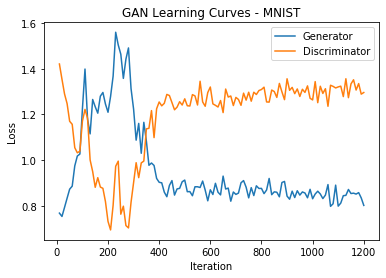

In [0]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('GAN Learning Curves - MNIST')
plt.show()

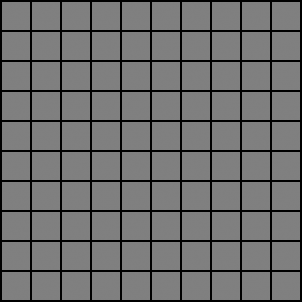

In [0]:
# Training generated samples
filenames = glob.glob(folder_path + "/*.png")
filenames.sort()
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('./GAN_MNIST.gif', images)
with open('./GAN_MNIST.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

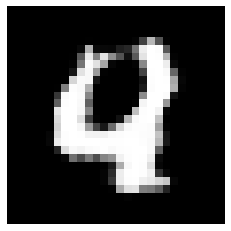

In [0]:
# Samples generation
GAN_generator_MNIST.eval()
test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = torch.FloatTensor(test_noise).view(1,62,1,1).cuda()
generated_img = GAN_generator_MNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

#### 1.2.2. Conjunto de Datos FashionMNIST

In [0]:
# Dataloader
batch_size = 100
dataloader = DataLoader(FashionMNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
D_net = Discriminator().cuda()

# Models weights initialization
G_net.apply(weights_init)
D_net.apply(weights_init)

# Loss function
binary_cross_entropy = nn.BCELoss().cuda()

# Optimizers
D_optimizer = optim.Adam(D_net.parameters(), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(G_net.parameters(), lr=1e-3, betas=(0.5, 0.99))

# Tensors
label = torch.FloatTensor(batch_size, 1).cuda()
noise = torch.FloatTensor(batch_size, 62).cuda()

# Fixed Noise Tensor (for visualization)
fixed_noise = torch.FloatTensor(100, 62).cuda()
fixed_noise.uniform_(-1, 1)
fixed_noise = fixed_noise.view(-1, 62, 1, 1)

# Train Losses (for visualization)
D_loss = []
G_loss = []

# Images Folder (for visualization)
folder_path = './imgs_FashionMNIST'
if not os.path.exists(folder_path):
    os.makedirs(folder_path)

# First sample generation (for visualization)
cnt = 1000
G_net.eval()
save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
G_net.train()

# Training Loop
print('Start Training...')
training_time = time.time()
for epoch in range(2):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    noise.uniform_(-1, 1)
    noise = noise.view(-1, 62, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(true_sample)
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(noise)
    fake_pred = D_net(fake_sample.detach())
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    # Discriminator loss
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator optimization
    G_optimizer.zero_grad()
    label.fill_(1)
    fake_pred = D_net(fake_sample)
    generator_loss = binary_cross_entropy(fake_pred, label)
    generator_loss.backward()
    G_optimizer.step()
    # Summary
    if (i % 10) == 0:
      cnt += 1
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      print('Iter: {} | Discriminator Loss: {} | Generator Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1]))
      G_net.eval()
      save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
      G_net.train()
print('Training Time: {} [min]'.format((time.time() - training_time) / 60))
GAN_generator_FashionMNIST = G_net

Start Training...
Iter: 0 | Discriminator Loss: 1.4434754848480225 | Generator Loss: 0.6910387277603149
Iter: 10 | Discriminator Loss: 1.3055503368377686 | Generator Loss: 0.7783076763153076
Iter: 20 | Discriminator Loss: 1.1983742713928223 | Generator Loss: 0.8475431203842163
Iter: 30 | Discriminator Loss: 1.0948718786239624 | Generator Loss: 0.9076233506202698
Iter: 40 | Discriminator Loss: 1.0440657138824463 | Generator Loss: 0.9429720044136047
Iter: 50 | Discriminator Loss: 0.9964714646339417 | Generator Loss: 1.0092142820358276
Iter: 60 | Discriminator Loss: 0.9072393178939819 | Generator Loss: 1.0808475017547607
Iter: 70 | Discriminator Loss: 0.8932982683181763 | Generator Loss: 1.1236299276351929
Iter: 80 | Discriminator Loss: 0.7928345203399658 | Generator Loss: 1.1844244003295898
Iter: 90 | Discriminator Loss: 0.7942612767219543 | Generator Loss: 1.2552303075790405
Iter: 100 | Discriminator Loss: 0.8292412757873535 | Generator Loss: 1.3180712461471558
Iter: 110 | Discriminator

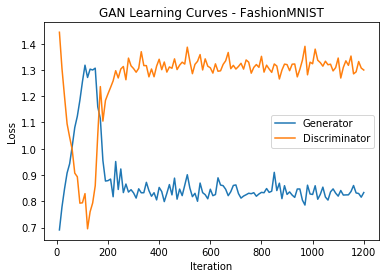

In [0]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('GAN Learning Curves - FashionMNIST')
plt.show()

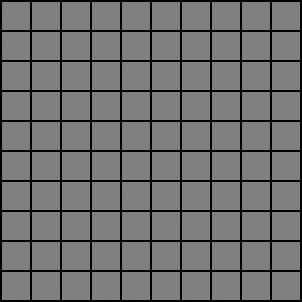

In [0]:
# Training generated samples
filenames = glob.glob(folder_path + "/*.png")
filenames.sort()
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('./GAN_FashionMNIST.gif', images)
with open('./GAN_FashionMNIST.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

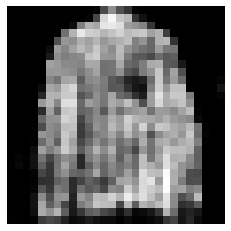

In [0]:
# Samples generation
GAN_generator_FashionMNIST.eval()
test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = torch.FloatTensor(test_noise).view(1,62,1,1).cuda()
generated_img = GAN_generator_FashionMNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

## 2\. InfoGAN: Interpretable Representation Learning by Information Maximizing Generative Adversarial Nets

El modelo InfoGAN consiste en una red neuronal generativa adversaria (GAN) que adicionalmente maximiza la información mutua entre un conjunto de variables latentes y las muestras sintéticas generadas para tener control de las características semánticas de estas últimas.

El modelo GAN utiliza un vector de ruido continuo factorizado $z\sim p_z$ sin imponer ninguna restricción a la forma en que el modelo $G$ utiliza dicho ruido para generar muestras en el espacio de los datos. En consecuencia, el ruido es utilizado de manera altamente acoplada, por lo cual, las dimensiones individuales del vector de ruido $z$ no corresponden a características semánticas de las muestras sintéticas.

Para controlar características semánticas de las muestras sintéticas, se adiciona como entrada al generador un conjunto de variables latentes estructuradas $c_1,c_2,...,c_L$ de distribución factorizada $P(c_1,c_2,...,c_L)=\prod_{i=1}^L P(c_i)$, maximizando la información mutua entre el código latente $c$ y la muestra sintética generada $G(z,c)$, es decir, se maximiza el término $I(c;G(z,c))$.

De este modo, el juego *minimax* a resolver resulta:

\begin{equation}
  \min\limits_{G}\max\limits_{D}V_I(D,G)=V(D,G)-\lambda I(c;G(z,c))
\end{equation}

con $V(D,G)$ el término de valor del juego *minimax* del modelo GAN y $\lambda$ un término de regularización.

Se observa que el término de información $I(c;G(z,c))$ de maximizar debido a que requiere acceso a la distribución posterior $P(c|x)$, por tanto, se propone un enfoque variacional para aproximar dicha distribución mediante una distribución auxiliar $Q(c|x)$ simple de calcular parametrizada mediante una red neuronal. 

>![InfoGAN Architecture](https://www.researchgate.net/profile/Wei_Chen362/publication/334009792/figure/fig1/AS:807400315572224@1569510644357/Architectures-of-the-standard-GAN-and-the-InfoGAN.ppm)

### 2.1. Fundamentos Teóricos

#### 2.1.1. Maximización Variacional de la Información Mutua

Debido a la dificultad de cálculo del término $P(c|x)$, se busca encontrar una cota inferior del término $I(c;G(z,c))$ utilizando una distribución auxiliar $Q(c|x)$. De este modo, se tiene que:

\begin{equation}
\begin{split}
  I(c;G(z,c))&=H(c)-H(c|G(z,c)) \\
             &=\mathbb{E}_{x\sim G(z,c)}[\mathbb{E}_{c'\sim P(c|x)}[\log P(c'|x)]]+H(c) \\
             &=\mathbb{E}_{x\sim G(z,c)}[\underbrace{D_{KL}\big(P(\cdot|x)||Q(\cdot|x)\big)}_{\geq 0}+\mathbb{E}_{c'\sim P(c|x)}[\log Q(c'|x)]]+H(c) \\
             &\geq \mathbb{E}_{x\sim G(z,c)} [\mathbb{E}_{c'\sim P(c|x)}[\log Q(c'|x)]]+H(c)
\end{split}
\end{equation}

donde se ha obtenido una cota inferior $L_I(Q,G)$ del término de información mutua el cual permite excluir el cómputo del término $P(c|x)$. Para evitar muestrear de la distribución $P(c|x)$ (en el cómputo de la esperanza) se hace uso del siguiente lema $(\mathbf{**})$.

**Lema.** *Para varianles aleatorias $X$,$Y$ y una función $f(x,y)$ que satisface ciertas condiciones de regularidad, se cumple que:* $\mathbb{E}_{x\sim X,y\sim Y|x}[f(x,y)]=\mathbb{E}_{x\sim X,y\sim Y|x, x'\sim X|y}[f(x'|y)]$.

De este modo, la cota inferior $L_I(Q,G)$ de la información mutua puede expresarse como:

\begin{equation}
  L_I(Q,G)=\mathbb{E}_{c\sim P(c), x\sim G(z,c)}[\log{Q(c|x)}]+H(c)
\end{equation}

Se observa que el término $L_I(G,Q)$ resulta simple de aproximar mediante simulación de Monte Carlo, pudiendo maximizarse con respecto a $Q$ directamente y con respecto a $G$ utilizando el *truco de reparametrización* $(\mathbf{***})$.

Por lo tanto, el término $L_I(G,Q)$ puede ser añadido directamente al juego *minimax* del modelo GAN como término variacional regularizado de la información mutua, resultando la siguiente expresión:

\begin{equation}
  \min\limits_{G,Q}\max\limits_{D}V_{\text{InfoGAN}}(D,G,Q)=V(D,G)-\lambda L_{I}(G,Q)
\end{equation}

### 2.2. Experimentos

In [0]:
class DiscriminatorAndRecognitionNet(nn.Module):
  '''Discriminator and recognition network mutual architecture (parameters sharing)'''
  def __init__(self):
    super(DiscriminatorAndRecognitionNet, self).__init__()
    self.main = nn.Sequential(
      nn.Conv2d(in_channels=1, out_channels=64, kernel_size=4, stride=2, padding=1),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=128, out_channels=1024, kernel_size=7, bias=False),
      nn.BatchNorm2d(num_features=1024),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
    )

  def forward(self, x):
    output = self.main(x)
    return output


class Discriminator(nn.Module):
  '''Discriminator network front architecture''' 
  def __init__(self):
    super(Discriminator, self).__init__()
    self.main = nn.Sequential(
      nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=1),
      nn.Sigmoid()
    )
    
  def forward(self, x):
    output = self.main(x).view(-1, 1)
    return output


class RecognitionNet(nn.Module):
  '''Recognition network (Q) front architecture'''
  def __init__(self):
    super(RecognitionNet, self).__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels=1024, out_channels=128, kernel_size=1, bias=False),
        nn.BatchNorm2d(num_features=128),
        nn.LeakyReLU(negative_slope=0.1, inplace=True)
    )
    self.convDiscrete = nn.Conv2d(in_channels=128, out_channels=10, kernel_size=1)
    self.convContinuous_mean = nn.Conv2d(in_channels=128, out_channels=2, kernel_size=1)
    self.convContinupus_var = nn.Conv2d(in_channels=128, out_channels=2, kernel_size=1)

  def forward(self, x):
    x = self.conv(x)
    logits = self.convDiscrete(x).squeeze()
    mean = self.convContinuous_mean(x).squeeze()
    variance = self.convContinupus_var(x).squeeze().exp()
    return logits, mean, variance 


class Generator(nn.Module):
  '''Generator network architecture''' 
  def __init__(self):
    super(Generator, self).__init__()
    self.deconv = nn.Sequential(
      nn.ConvTranspose2d(in_channels=74, out_channels=1024, kernel_size=1, stride=1, bias=False),
      nn.BatchNorm2d(1024),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=1024, out_channels=128, kernel_size=7, stride=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=64),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=64, out_channels=1, kernel_size=4, stride=2, padding=1, bias=False),
      nn.Sigmoid()
    )

  def forward(self, x):
    output = self.deconv(x)
    return output

def weights_init(m):
  '''Models parameters initialization'''
  if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
    nn.init.normal_(m.weight, mean=0.0, std=0.02)
  elif isinstance(m, (nn.BatchNorm2d)):
    nn.init.normal_(m.weight, mean=1.0, std=0.02)
    nn.init.constant_(m.bias, val=0)

class GaussianNLL():
  '''Independant Gaussian Negative Log-likelihood'''
  def __call__(self, x, mu, var):
    logli = -0.5 * (var.mul(2 * np.pi) + 1e-6).log() - (x - mu).pow(2).div(var.mul(2.0) + 1e-6)
    nll = logli.sum(1).mean().mul(-1)
    return nll

#### 2.2.1. Conjunto de Datos MNIST

In [0]:
# Dataset
batch_size = 100
dataloader = DataLoader(MNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
DQ_mutual_net = DiscriminatorAndRecognitionNet().cuda()
D_net = Discriminator().cuda()
Q_net = RecognitionNet().cuda()

# Models weights initialization
G_net.apply(weights_init)
DQ_mutual_net.apply(weights_init)
D_net.apply(weights_init)
Q_net.apply(weights_init)

# Loss functions
binary_cross_entropy = nn.BCELoss().cuda()
cross_entropy = nn.CrossEntropyLoss().cuda()
gaussian_NLL = GaussianNLL()

# Optimizers
D_optimizer = optim.Adam(list(D_net.parameters()) + list(DQ_mutual_net.parameters()), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(list(G_net.parameters()) + list(Q_net.parameters()), lr=1e-3, betas=(0.5, 0.99))

# Tensors
noise = torch.FloatTensor(batch_size, 62).cuda()
categorical_code = torch.FloatTensor(batch_size, 10).cuda()
continuous_code = torch.FloatTensor(batch_size, 2).cuda()
label = torch.FloatTensor(batch_size, 1).cuda()

# Mutual information factors
lambda_cat = 1
lambda_con = 0.1

# Train Losses (for visualization)
D_loss = []
G_loss = []
I_loss = []

# Training Loop
print('Start Training...')
training_time = time.time()
for epoch in range(10):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    ### Latent space and code sampling
    noise = noise.uniform_(-1, 1)
    categorical_code = categorical_code.fill_(0)
    idx_categorical_code = np.random.randint(10, size=batch_size)
    categorical_code[range(batch_size), idx_categorical_code] = 1.0
    continuous_code = continuous_code.uniform_(-1, 1)
    z = torch.cat([noise, categorical_code, continuous_code], axis=1).view(-1, 74, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(DQ_mutual_net(true_sample))
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(z)
    fake_pred = D_net(DQ_mutual_net(fake_sample.detach()))
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator optimization
    G_optimizer.zero_grad()
    # Fake sample
    label.fill_(1)
    fake_pred = D_net(DQ_mutual_net(fake_sample))
    fake_loss = binary_cross_entropy(fake_pred, label)
    # Mutual information
    q_logits, q_mean, q_std = Q_net(DQ_mutual_net(fake_sample))
    categorical_code_idx = torch.LongTensor(idx_categorical_code).cuda()
    info_loss = lambda_cat * cross_entropy(q_logits, categorical_code_idx) + \
                lambda_con * gaussian_NLL(continuous_code, q_mean, q_std)
    generator_loss = fake_loss + info_loss
    generator_loss.backward()
    G_optimizer.step()
    # Summary
    if (i % 10) == 0:
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      I_loss.append(info_loss.cpu().detach().numpy().item())
      print('Iter: {} | Discriminator Loss: {} | Generator Loss: {} | Info Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1], I_loss[-1]))
print('Training Time: {} [min]'.format((time.time() - training_time) / 60))
InfoGAN_generator_MNIST = G_net

Start Training...
Iter: 0 | Discriminator Loss: 1.424908995628357 | Generator Loss: 3.2801144123077393 | Info Loss: 2.541457414627075
Iter: 10 | Discriminator Loss: 1.3605868816375732 | Generator Loss: 2.0024781227111816 | Info Loss: 1.23981511592865
Iter: 20 | Discriminator Loss: 1.2854799032211304 | Generator Loss: 1.4716362953186035 | Info Loss: 0.6579806208610535
Iter: 30 | Discriminator Loss: 1.2427856922149658 | Generator Loss: 1.246144413948059 | Info Loss: 0.4134990870952606
Iter: 40 | Discriminator Loss: 1.1634142398834229 | Generator Loss: 1.1781229972839355 | Info Loss: 0.2837941646575928
Iter: 50 | Discriminator Loss: 1.0928020477294922 | Generator Loss: 1.1295568943023682 | Info Loss: 0.1910312920808792
Iter: 60 | Discriminator Loss: 1.0639660358428955 | Generator Loss: 1.1293666362762451 | Info Loss: 0.12563511729240417
Iter: 70 | Discriminator Loss: 0.969292402267456 | Generator Loss: 1.1390125751495361 | Info Loss: 0.06860780715942383
Iter: 80 | Discriminator Loss: 0.93

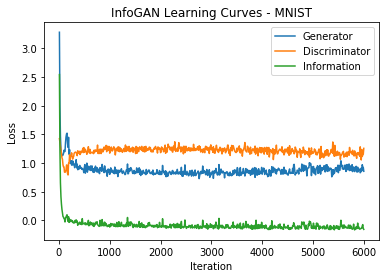

In [0]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.plot(np.array(range(1, len(I_loss) + 1)) * 10, I_loss, label='Information')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('InfoGAN Learning Curves - MNIST')
plt.show()

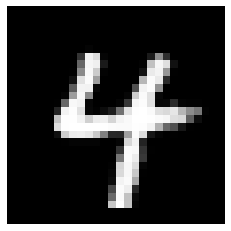

In [0]:
#@title Samples Generation { run: "auto" }
#@markdown #### Code values:
C1 = 2 #@param {type:"slider", min:0, max:9, step:1}
C2 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
C3 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
#@markdown #### Sample new noise value:
new_noise = True #@param {type:"boolean"}
c1 = np.zeros((1,10))
c1[:,C1] = 1
c2 = np.array([[C2]])
c3 = np.array([[C3]])
InfoGAN_generator_MNIST.eval()
if new_noise:
  test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = np.hstack([test_noise, c1, c2, c3])
z_test = torch.FloatTensor(z_test).view(1,74,1,1).cuda()
generated_img = InfoGAN_generator_MNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

#### 2.2.2. Conjunto de Datos FashionMNIST

In [0]:
# Dataset
batch_size = 100
dataloader = DataLoader(FashionMNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
DQ_mutual_net = DiscriminatorAndRecognitionNet().cuda()
D_net = Discriminator().cuda()
Q_net = RecognitionNet().cuda()

# Models weights initialization
G_net.apply(weights_init)
DQ_mutual_net.apply(weights_init)
D_net.apply(weights_init)
Q_net.apply(weights_init)

# Loss functions
binary_cross_entropy = nn.BCELoss().cuda()
cross_entropy = nn.CrossEntropyLoss().cuda()
gaussian_NLL = GaussianNLL()

# Optimizers
D_optimizer = optim.Adam(list(D_net.parameters()) + list(DQ_mutual_net.parameters()), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(list(G_net.parameters()) + list(Q_net.parameters()), lr=1e-3, betas=(0.5, 0.99))

# Tensors
noise = torch.FloatTensor(batch_size, 62).cuda()
categorical_code = torch.FloatTensor(batch_size, 10).cuda()
continuous_code = torch.FloatTensor(batch_size, 2).cuda()
label = torch.FloatTensor(batch_size, 1).cuda()

# Mutual information factors
lambda_cat = 1
lambda_con = 0.1

# Train Losses (for visualization)
D_loss = []
G_loss = []
I_loss = []

# Training Loop
print('Start Training...')
training_time = time.time()
for epoch in range(10):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    ### Latent space and code sampling
    noise = noise.uniform_(-1, 1)
    categorical_code = categorical_code.fill_(0)
    idx_categorical_code = np.random.randint(10, size=batch_size)
    categorical_code[range(batch_size), idx_categorical_code] = 1.0
    continuous_code = continuous_code.uniform_(-1, 1)
    z = torch.cat([noise, categorical_code, continuous_code], axis=1).view(-1, 74, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(DQ_mutual_net(true_sample))
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(z)
    fake_pred = D_net(DQ_mutual_net(fake_sample.detach()))
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator optimization
    G_optimizer.zero_grad()
    # Fake sample
    label.fill_(1)
    fake_pred = D_net(DQ_mutual_net(fake_sample))
    fake_loss = binary_cross_entropy(fake_pred, label)
    # Mutual information
    q_logits, q_mean, q_std = Q_net(DQ_mutual_net(fake_sample))
    categorical_code_idx = torch.LongTensor(idx_categorical_code).cuda()
    info_loss = lambda_cat * cross_entropy(q_logits, categorical_code_idx) + \
                lambda_con * gaussian_NLL(continuous_code, q_mean, q_std)
    generator_loss = fake_loss + info_loss
    generator_loss.backward()
    G_optimizer.step()
    # Summary
    if (i % 10) == 0:
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      I_loss.append(info_loss.cpu().detach().numpy().item())
      print('Iter: {} | Discriminator Loss: {} | Generator Loss: {} | Info Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1], I_loss[-1]))
print('Training Time: {} [min]'.format((time.time() - training_time) / 60))
InfoGAN_generator_FashionMNIST = G_net

Start Training...
Iter: 0 | Discriminator Loss: 1.4394733905792236 | Generator Loss: 3.274200677871704 | Info Loss: 2.4944589138031006
Iter: 10 | Discriminator Loss: 1.2952214479446411 | Generator Loss: 1.9973742961883545 | Info Loss: 1.223313331604004
Iter: 20 | Discriminator Loss: 1.1789603233337402 | Generator Loss: 1.473907709121704 | Info Loss: 0.6136382222175598
Iter: 30 | Discriminator Loss: 1.0948519706726074 | Generator Loss: 1.28778076171875 | Info Loss: 0.3703707456588745
Iter: 40 | Discriminator Loss: 1.0212593078613281 | Generator Loss: 1.2374166250228882 | Info Loss: 0.25106850266456604
Iter: 50 | Discriminator Loss: 0.9333294630050659 | Generator Loss: 1.1934813261032104 | Info Loss: 0.14102117717266083
Iter: 60 | Discriminator Loss: 0.8877535462379456 | Generator Loss: 1.2328895330429077 | Info Loss: 0.11957291513681412
Iter: 70 | Discriminator Loss: 0.8600842356681824 | Generator Loss: 1.1988695859909058 | Info Loss: 0.05155715346336365
Iter: 80 | Discriminator Loss: 0

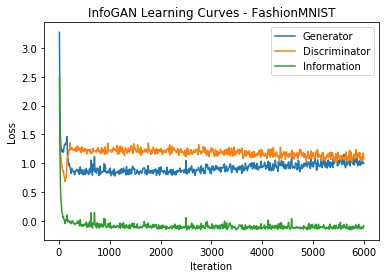

In [0]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.plot(np.array(range(1, len(I_loss) + 1)) * 10, I_loss, label='Information')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('InfoGAN Learning Curves - FashionMNIST')
plt.show()

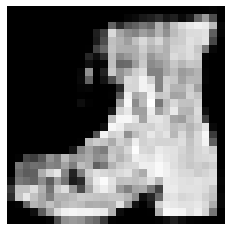

In [0]:
#@title Samples Generation { run: "auto" }
#@markdown #### Code values:
C1 = 3 #@param {type:"slider", min:0, max:9, step:1}
C2 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
C3 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
#@markdown #### Sample new noise value:
new_noise = True #@param {type:"boolean"}
c1 = np.zeros((1,10))
c1[:,C1] = 1
c2 = np.array([[C2]])
c3 = np.array([[C3]])
InfoGAN_generator_FashionMNIST.eval()
if new_noise:
  test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = np.hstack([test_noise, c1, c2, c3])
z_test = torch.FloatTensor(z_test).view(1,74,1,1).cuda()
generated_img = InfoGAN_generator_FashionMNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

## 3\. Resumen



*   Se presentaron los fundamentos teóricos y ejemplos prácticos de los modelos GAN e InfoGAN.
*   Se mostró el vínculo directo de las medidas de información en los resultados teóricos del modelo GAN. 
*   Se utilizó la medida de información mutua aproximada de manera variacional para la obtención de representaciones interpretables de las muestras sintéticas generadas por dicho modelo.



## 4\. Tarea



*   En la sección 1.1.2 se utilizó el siguiente resultado en la demostración de la expresión del discriminador óptimo $D^*_G$ dado un generador $G$ $(\mathbf{*})$:

\begin{equation}
    \int_z p_z(z)\log{(1-D(G(z)))}=\int_x p_{g(x)}(x)\log{(1-D(x))}dx
\end{equation}

Demuestre la igualdad presentada.

*   Demuestre el lema enunciado en la sección 2.1.1 $(\mathbf{**})$ y con ello demuestre que la cota inferior variacional de la información mutua puede expresarse como $L_I(G,Q)=\mathbb{E}_{c\sim P(c), x\sim G(z,c)}[\log{Q(c|x)}]+H(c)$.

*   Enuncie y demuestre el *truco de reparametrización*  mencionado en la sección 2.1.1 $(\mathbf{***})$ y con ello demuestre que es posible maximizar la cota inferior variacional de la información mutua $L_I(G,Q)$ con respecto a $G$.

*   Utilice el modelo $\text{GAN}$ e $\text{InfoGAN}$ para generar muestras sintéticas del conjuntos de datos espiral y del conjunto de datos de 25 gaussianas. Grafique 1000 muestras sintéticas sobre 1000 datos obtenidos de la distribución original utilizando ambos modelos. Analice y explique las diferencias observadas. **Hint:** Investigue sobre el fenómeno de colapso de modo (*mode collapse*).

*   En la sección 2 se mostró que el juego *minimax* original para el entrenamiento del modelo InfoGAN explicitaba el término regularizado de la información mutua $I(c,G(z,c))$, el cual fue aproximado variacionalmente debido a la imposibilidad de computar la distribución $P(c|x)$. Implemente el juego $minimax$ original utilizando el estimador neuronal de la información mutua [$\text{MINE}$](https://arxiv.org/pdf/1801.04062.pdf) estudiado en la cápsula anterior. Compare, analice y comente los resultados obtenidos entre el modelo $\text{InfoGAN}$ original y el modelo $\text{MINE-InfoGAN}$.

